In [249]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
#pio.renderers.default = 'colab'   # try changing this in case your plots aren't shown
import pandas as pd
import plotly as plt
import seaborn as sns
from pandas import json_normalize
import geopandas as gpd

In [205]:
from urllib.request import urlopen
import json
with urlopen('https://swisspost.opendatasoft.com/api/v2/catalog/datasets/plz_verzeichnis_v2/exports/geojson') as response:
    village_PLZ = json.load(response)
    
   


In [125]:
village_PLZ

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': None,
   'properties': {'rec_art': '01',
    'onrp': 105,
    'bfsnr': 5586,
    'plz_typ': 80,
    'postleitzahl': '1000',
    'plz_zz': '01',
    'gplz': 1000,
    'ortbez18': 'Lausanne 1 Dépôt',
    'ortbez27': 'Lausanne 1 Dépôt',
    'kanton': 'VD',
    'sprachcode': 2,
    'sprachcode_abw': None,
    'briefz_durch': 130,
    'gilt_ab_dat': '2005-04-01',
    'plz_briefzust': 100060,
    'plz_coff': None,
    'geo_shape': None,
    'geo_point_2d': None}},
  {'type': 'Feature',
   'geometry': None,
   'properties': {'rec_art': '01',
    'onrp': 107,
    'bfsnr': 5586,
    'plz_typ': 80,
    'postleitzahl': '1000',
    'plz_zz': '03',
    'gplz': 1000,
    'ortbez18': 'Lausanne 3',
    'ortbez27': 'Lausanne 3',
    'kanton': 'VD',
    'sprachcode': 2,
    'sprachcode_abw': None,
    'briefz_durch': 130,
    'gilt_ab_dat': '1986-05-21',
    'plz_briefzust': 100060,
    'plz_coff': None,
    'geo_shape': None

In [206]:
df_json = json_normalize(village_PLZ["features"]).reset_index()
df_json.head()

,index,type,geometry,properties.rec_art,properties.onrp,properties.bfsnr,properties.plz_typ,properties.postleitzahl,properties.plz_zz,properties.gplz,...,properties.briefz_durch,properties.gilt_ab_dat,properties.plz_briefzust,properties.plz_coff,properties.geo_shape,properties.geo_point_2d,geometry.coordinates,geometry.type,properties.geo_point_2d.lon,properties.geo_point_2d.lat
0,0,Feature,NaN,01,105,5586,80,1000,01,1000,...,130,2005-04-01,100060,None,NaN,NaN,NaN,NaN,NaN,NaN
1,1,Feature,NaN,01,107,5586,80,1000,03,1000,...,130,1986-05-21,100060,None,NaN,NaN,NaN,NaN,NaN,NaN
2,2,Feature,NaN,01,110,5586,80,1000,06,1000,...,130,1993-02-10,100060,None,NaN,NaN,NaN,NaN,NaN,NaN
3,3,Feature,NaN,01,112,5586,80,1000,08,1000,...,130,1997-05-20,100060,None,NaN,NaN,NaN,NaN,NaN,NaN
4,4,Feature,NaN,01,121,5586,80,1000,21,1000,...,130,1986-05-21,100060,None,NaN,NaN,NaN,NaN,NaN,NaN


In [207]:
df_json.keys()

Index(['index', 'type', 'geometry', 'properties.rec_art', 'properties.onrp',
       'properties.bfsnr', 'properties.plz_typ', 'properties.postleitzahl',
       'properties.plz_zz', 'properties.gplz', 'properties.ortbez18',
       'properties.ortbez27', 'properties.kanton', 'properties.sprachcode',
       'properties.sprachcode_abw', 'properties.briefz_durch',
       'properties.gilt_ab_dat', 'properties.plz_briefzust',
       'properties.plz_coff', 'properties.geo_shape',
       'properties.geo_point_2d', 'geometry.coordinates', 'geometry.type',
       'properties.geo_point_2d.lon', 'properties.geo_point_2d.lat'],
      dtype='object')

In [233]:
df_plz = df_json[['properties.postleitzahl', 'properties.ortbez27','properties.kanton','geometry.coordinates', 'geometry.type',
       'properties.geo_point_2d.lon', 'properties.geo_point_2d.lat'  ]].copy()
df_plz = df_plz.drop(['geometry.coordinates', 'geometry.type'], axis=1)
df_plz = df_plz.dropna()
df_plz

,properties.postleitzahl,properties.ortbez27,properties.kanton,properties.geo_point_2d.lon,properties.geo_point_2d.lat
6,1000,Lausanne 26,VD,6.696225,46.555666
8,1005,Lausanne,VD,6.643191,46.521727
9,1011,Lausanne,VD,6.643320,46.525556
10,1020,Renens VD,VD,6.589670,46.535280
11,1023,Crissier,VD,6.577725,46.556323
...,...,...,...,...,...
5205,1721,Cournillens,FR,7.100164,46.855505
5206,3961,Mission,VS,7.596625,46.195587
5236,7606,Bondo,GR,9.579828,46.314718
5251,6548,Sta. Domenica,GR,9.116585,46.348792


In [234]:
df_plz.to_csv('Plz.csv')

In [210]:
df_plz.rename(columns = {'properties.ortbez27' : 'headquarter'}, inplace = True)

df_plz

,properties.postleitzahl,headquarter,properties.kanton,geometry.coordinates,geometry.type,properties.geo_point_2d.lon,properties.geo_point_2d.lat
6,1000,Lausanne 26,VD,"[[[6.6981721445, 46.5426105695], [6.6981684569...",Polygon,6.696225,46.555666
8,1005,Lausanne,VD,"[[[6.6512274817, 46.513633142], [6.6512525303,...",Polygon,6.643191,46.521727
9,1011,Lausanne,VD,"[[[6.6445322932, 46.5271438743], [6.6444673481...",Polygon,6.643320,46.525556
10,1020,Renens VD,VD,"[[[6.6021326495, 46.5246329894], [6.6021354726...",Polygon,6.589670,46.535280
11,1023,Crissier,VD,"[[[6.5773518011, 46.5385330891], [6.5773666741...",Polygon,6.577725,46.556323
...,...,...,...,...,...,...,...
5205,1721,Cournillens,FR,"[[[7.0867063027, 46.8484342377], [7.0868493649...",Polygon,7.100164,46.855505
5206,3961,Mission,VS,"[[[7.6054167145, 46.203096374], [7.6057226541,...",Polygon,7.596625,46.195587
5236,7606,Bondo,GR,"[[[9.5645649666, 46.3343941962], [9.5573582496...",Polygon,9.579828,46.314718
5251,6548,Sta. Domenica,GR,"[[[9.071150955, 46.3435888936], [9.071176678, ...",Polygon,9.116585,46.348792


In [130]:
# wichtige Daten aus den Geojson
# 'postleitzahl'
# 'ortbez18'

In [213]:
#
df = pd.read_csv('all_top_100_startups.csv')
df.head()


,Unnamed: 0.1,Unnamed: 0,rank,name,headquarter,category,description,link,year
0,0,0,1,Yokoy Group AG,Zurich,Fintech,Your expenses and company credit cards on auto...,https://www.top100startups.swiss/yokoy,2022
1,1,1,2,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2022
2,2,2,3,Ledgy AG,Zurich,Fintech,Your equity set for growth,https://www.top100startups.swiss/Ledgy,2022
3,3,3,4,CUTISS AG,Schlieren,Biotech,Personalized skin,https://www.top100startups.swiss/CUTISS,2022
4,4,4,5,CREAL SA,Ecublens,Engineering,Enabling Augmented Reality within arm's reach,https://www.top100startups.swiss/CREAL,2022


In [202]:

df.shape

(1197, 9)

In [231]:
# Dataframe with PLZ
df_all_startups = pd.merge(df, df_plz,    on = 'headquarter',  how = 'inner', suffixes=('left', '_remove'))

df_all_startups

,Unnamed: 0.1,Unnamed: 0,rank,name,headquarter,category,description,link,year,properties.postleitzahl,properties.kanton,geometry.coordinates,geometry.type,properties.geo_point_2d.lon,properties.geo_point_2d.lat
0,1,1,2,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2022,8310,ZH,"[[[8.7039425147, 47.4394292727], [8.7044302963...",Polygon,8.711552,47.457439
1,0,0,1,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2021,8310,ZH,"[[[8.7039425147, 47.4394292727], [8.7044302963...",Polygon,8.711552,47.457439
2,38,38,39,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2021,8310,ZH,"[[[8.7039425147, 47.4394292727], [8.7044302963...",Polygon,8.711552,47.457439
3,17,17,18,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2020,8310,ZH,"[[[8.7039425147, 47.4394292727], [8.7044302963...",Polygon,8.711552,47.457439
4,36,36,37,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2020,8310,ZH,"[[[8.7039425147, 47.4394292727], [8.7044302963...",Polygon,8.711552,47.457439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10138,81,81,83,kringlan composites AG,Otelfingen,Engineering,Development of high-performance thermoplastic ...,https://www.top100startups.swiss/kringlan,2011,8112,ZH,"[[[8.417017781, 47.4507138795], [8.4170192567,...",Polygon,8.389700,47.464525
10139,81,81,83,Telormedix SA,Bioggio,Biotech,Targeted immunity in the treatment of cancer a...,https://www.top100startups.swiss/Telormedix,2012,6934,TI,"[[[8.9120336697, 46.0041765749], [8.9120402031...",Polygon,8.912732,46.015135
10140,30,30,31,Optical Additives GmbH,Staufen,Engineering,Convert any surface into a solar cell,https://www.top100startups.swiss/Optical,2011,5603,AG,"[[[8.1610796416, 47.3651842045], [8.1610802578...",Polygon,8.159970,47.378760
10141,80,80,82,unblu inc.,Sarnen,ICT,Integrating telephone and online communication,https://www.top100startups.swiss/unblu,2011,6060,OW,"[[[8.2354645293, 46.8814119825], [8.2354725253...",Polygon,8.247361,46.895848


In [225]:
df_all_startups = df_all_startups.drop(['Unnamed: 0', "Unnamed: 0.1", 'geometry.coordinates', 'geometry.type'], axis=1)
df_all_startups.rename(columns = {'properties.postleitzahl' : 'plz', 'properties.kanton' : 'kanton','properties.geo_point_2d.lon': 'lon', 'properties.geo_point_2d.lat' : 'lat'  }, inplace = True)


df_all_startups

,rank,name,headquarter,category,description,link,year,plz,kanton,lon,lat
0,2,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2022,8310,ZH,8.711552,47.457439
1,1,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2021,8310,ZH,8.711552,47.457439
2,39,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2021,8310,ZH,8.711552,47.457439
3,18,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2020,8310,ZH,8.711552,47.457439
4,37,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2020,8310,ZH,8.711552,47.457439
...,...,...,...,...,...,...,...,...,...,...,...
10138,83,kringlan composites AG,Otelfingen,Engineering,Development of high-performance thermoplastic ...,https://www.top100startups.swiss/kringlan,2011,8112,ZH,8.389700,47.464525
10139,83,Telormedix SA,Bioggio,Biotech,Targeted immunity in the treatment of cancer a...,https://www.top100startups.swiss/Telormedix,2012,6934,TI,8.912732,46.015135
10140,31,Optical Additives GmbH,Staufen,Engineering,Convert any surface into a solar cell,https://www.top100startups.swiss/Optical,2011,5603,AG,8.159970,47.378760
10141,82,unblu inc.,Sarnen,ICT,Integrating telephone and online communication,https://www.top100startups.swiss/unblu,2011,6060,OW,8.247361,46.895848


In [226]:
df_all_startups_clean = df_all_startups.drop_duplicates([ 'rank','name', 'headquarter',  'category', 'description','link', 'year'])
df_all_startups_clean

,rank,name,headquarter,category,description,link,year,plz,kanton,lon,lat
0,2,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2022,8310,ZH,8.711552,47.457439
1,1,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2021,8310,ZH,8.711552,47.457439
2,39,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2021,8310,ZH,8.711552,47.457439
3,18,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2020,8310,ZH,8.711552,47.457439
4,37,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2020,8310,ZH,8.711552,47.457439
...,...,...,...,...,...,...,...,...,...,...,...
10138,83,kringlan composites AG,Otelfingen,Engineering,Development of high-performance thermoplastic ...,https://www.top100startups.swiss/kringlan,2011,8112,ZH,8.389700,47.464525
10139,83,Telormedix SA,Bioggio,Biotech,Targeted immunity in the treatment of cancer a...,https://www.top100startups.swiss/Telormedix,2012,6934,TI,8.912732,46.015135
10140,31,Optical Additives GmbH,Staufen,Engineering,Convert any surface into a solar cell,https://www.top100startups.swiss/Optical,2011,5603,AG,8.159970,47.378760
10141,82,unblu inc.,Sarnen,ICT,Integrating telephone and online communication,https://www.top100startups.swiss/unblu,2011,6060,OW,8.247361,46.895848


In [222]:
df_all_startups_clean = df_all_startups.drop_duplicates(['link', 'description', 'name', 'year', 'rank', 'category']).reset_index()
df_all_startups_clean = df_all_startups_clean.drop(['Unnamed: 0', "Unnamed: 0.1", 'geometry.coordinates', 'geometry.type'], axis=1)

df_all_startups_clean.shape
df_all_startups_clean

,index,rank,name,headquarter,category,description,link,year,properties.postleitzahl,properties.kanton,properties.geo_point_2d.lon,properties.geo_point_2d.lat
0,0,2,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2022,8310,ZH,8.711552,47.457439
1,1,1,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2021,8310,ZH,8.711552,47.457439
2,2,39,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2021,8310,ZH,8.711552,47.457439
3,3,18,Haelixa AG,Kemptthal,Biotech,Reliable product identification through DNA te...,https://www.top100startups.swiss/Haelixa,2020,8310,ZH,8.711552,47.457439
4,4,37,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2020,8310,ZH,8.711552,47.457439
...,...,...,...,...,...,...,...,...,...,...,...,...
950,10138,83,kringlan composites AG,Otelfingen,Engineering,Development of high-performance thermoplastic ...,https://www.top100startups.swiss/kringlan,2011,8112,ZH,8.389700,47.464525
951,10139,83,Telormedix SA,Bioggio,Biotech,Targeted immunity in the treatment of cancer a...,https://www.top100startups.swiss/Telormedix,2012,6934,TI,8.912732,46.015135
952,10140,31,Optical Additives GmbH,Staufen,Engineering,Convert any surface into a solar cell,https://www.top100startups.swiss/Optical,2011,5603,AG,8.159970,47.378760
953,10141,82,unblu inc.,Sarnen,ICT,Integrating telephone and online communication,https://www.top100startups.swiss/unblu,2011,6060,OW,8.247361,46.895848


In [160]:
df_all_startups_clean2.to_csv('df_all_startups_clean.csv')

In [19]:
df_all_startups.to_csv('Top_100_Startups_Kanton.csv')

In [20]:
df.to_csv('file1.csv')

In [31]:
df_all_startups.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20502 entries, 0 to 20501
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   rank         20502 non-null  int64  
 1   name         20502 non-null  object 
 2   headquarter  20502 non-null  object 
 3   category     20502 non-null  object 
 4   description  20502 non-null  object 
 5   link         20502 non-null  object 
 6   year         20502 non-null  int64  
 7   plz          20502 non-null  object 
 8   kanton       20502 non-null  object 
 9   lon          10143 non-null  float64
 10  lat          10143 non-null  float64
dtypes: float64(2), int64(2), object(7)
memory usage: 1.9+ MB


In [33]:
df_all_startups_groupped = df_all_startups.groupby(['headquarter', 'lat', 'lon']).size().reset_index(name="count")
df_all_startups_groupped

,headquarter,lat,lon,count
0,Adliswil,47.309314,8.521283,1
1,Allschwil,47.545050,7.537497,5
2,Aubonne,46.490963,6.385609,1
3,Bannwil,47.238504,7.730333,5
4,Basel,47.530919,7.593903,54
...,...,...,...,...
165,Zürich,47.400645,8.578133,299
166,Zürich,47.408529,8.494431,299
167,Zürich,47.411888,8.551189,299
168,Zürich,47.422142,8.509156,299


In [261]:
#
df_all_startups_canton = pd.read_csv('all_top_100_startups_cantons.csv', sep=";")
df_all_startups_canton

,rank,name,headquarter,category,description,link,year,plz,kanton,lan,lon
0,1,Yokoy Group AG,Zurich,Fintech,Your expenses and company credit cards on auto...,https://www.top100startups.swiss/yokoy,2022,8001.0,ZH,8.541735,47.372087
1,2,Planted Foods AG,Kemptthal,Foodtech,Planted meats,https://www.top100startups.swiss/Planted,2022,8310.0,ZH,8.711552,47.457439
2,3,Ledgy AG,Zurich,Fintech,Your equity set for growth,https://www.top100startups.swiss/Ledgy,2022,8001.0,ZH,8.541735,47.372087
3,4,CUTISS AG,Schlieren,Biotech,Personalized skin,https://www.top100startups.swiss/CUTISS,2022,8952.0,ZH,8.449002,47.395034
4,5,CREAL SA,Ecublens,Engineering,Enabling Augmented Reality within arm's reach,https://www.top100startups.swiss/CREAL,2022,1024.0,VD,6.558615,46.528831
...,...,...,...,...,...,...,...,...,...,...,...
1192,95,Aeon Scientific AG,Schlieren,Medtech,Electromagnetic guidance of medical instrument...,https://www.top100startups.swiss/Aeon,2011,8952.0,ZH,8.449002,47.395034
1193,96,Qvanteq AG,ZÃ¼rich,Medtech,Novel stent technologies to address and overco...,https://www.top100startups.swiss/Qvanteq,2011,8002.0,ZH,8.532739,47.360072
1194,97,QGel SA,Lausanne,Biotech,A novel hydrogel material,https://www.top100startups.swiss/QGel,2011,1005.0,VD,6.643191,46.521726
1195,99,Prediggo SA,Vevey,ICT,Intelligent cross selling solutions for eShops.,https://www.top100startups.swiss/Prediggo,2011,1800.0,VD,6.837315,46.449638


In [262]:
df_all_startups_canton.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1197 entries, 0 to 1196
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   rank         1197 non-null   int64  
 1   name         1197 non-null   object 
 2   headquarter  1190 non-null   object 
 3   category     1197 non-null   object 
 4   description  1197 non-null   object 
 5   link         1197 non-null   object 
 6   year         1197 non-null   int64  
 7   plz          1178 non-null   float64
 8   kanton       1178 non-null   object 
 9   lan          1178 non-null   float64
 10  lon          1178 non-null   float64
dtypes: float64(3), int64(2), object(6)
memory usage: 103.0+ KB


In [288]:
df_all_startups_canton_groupped = df_all_startups_canton.groupby([ 'lan', 'lon']).size().reset_index(name="count")

df_all_startups_canton_groupped

,lan,lon,count
0,6.035029,46.214296,2
1,6.079550,46.213904,3
2,6.106156,46.224013,2
3,6.118033,46.164159,21
4,6.146917,46.210740,9
...,...,...,...
97,9.529882,46.852805,3
98,9.534855,47.440818,1
99,9.577188,46.961626,4
100,9.637593,47.400706,3


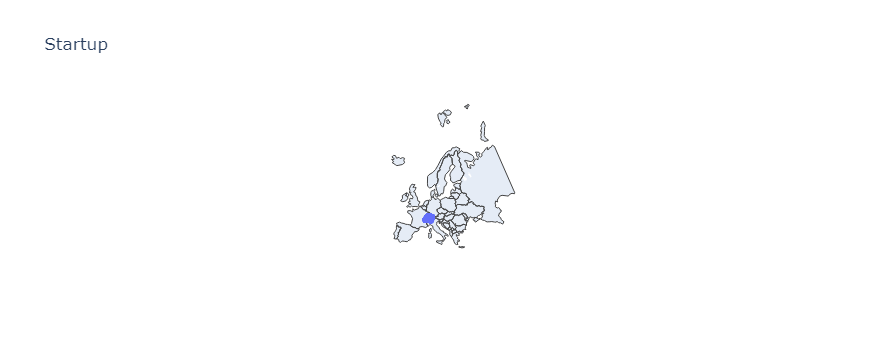

In [24]:
fig = go.Figure(data=go.Scattergeo(
        lon = df_all_startups['lon'],
        lat = df_all_startups['lat'],
        text = df_all_startups['name'],
        mode = 'markers',
        #marker_color = df_all_startups['category'],
        ))

fig.update_layout(
        title = 'Startup',
        geo_scope='europe',
    )
fig.show()

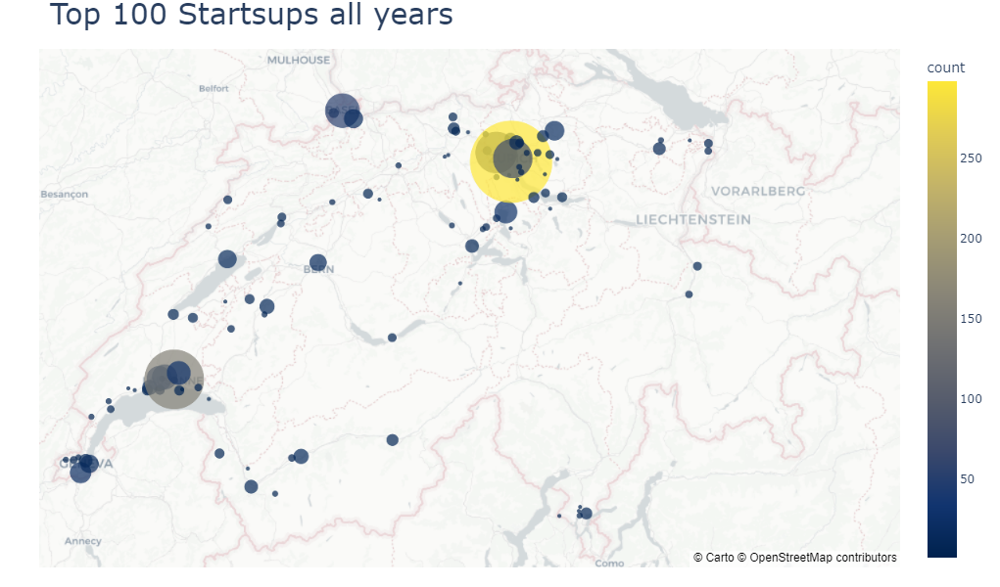

In [291]:

fig = px.scatter_mapbox(df_all_startups_canton_groupped, lat="lon", lon="lan",
                        color="count", size="count",
                        mapbox_style = 'carto-positron',
                        color_continuous_scale='cividis', 
                        size_max=60, 
                        zoom=7, 
                        width = 1000,  
                        height=600,
                        center={"lat": 46.8, "lon": 8.3},)


fig.update_layout(title_text="Top 100 Startsups all years",
                  margin=dict(l=40, r=30, t=50, b=20),
                
                  title_font_size=30)
fig.show()

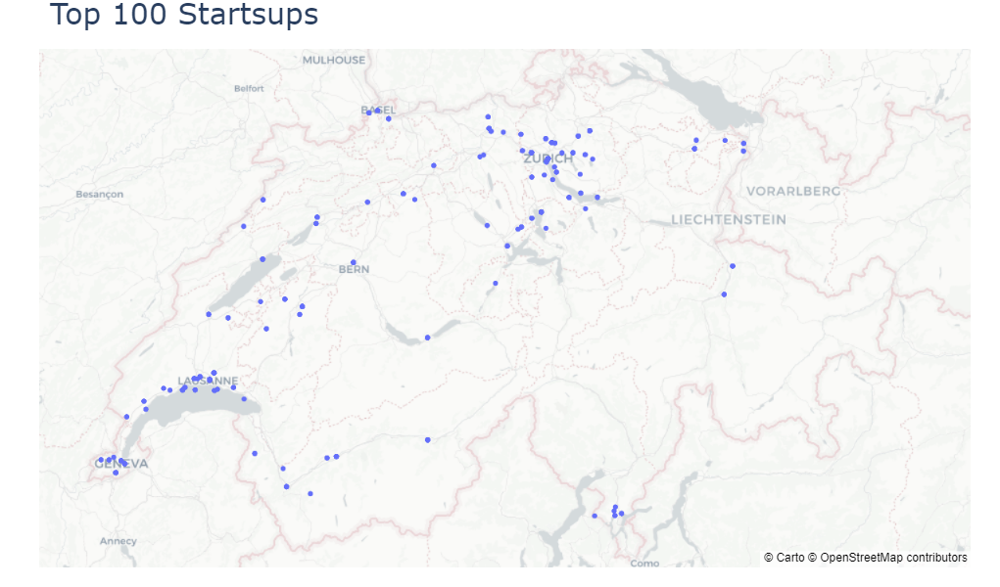

In [278]:
fig1 = px.scatter_mapbox(df_all_startups_canton,
                        lat= 'lon' ,
                        lon= 'lan',
                        hover_name="name",
                        mapbox_style = 'carto-positron',
                        size_max=30, 
                        zoom=7, 
                        width = 1000,  
                        height=600,
                        center={"lat": 46.8, "lon": 8.3},)

fig1.update_layout(title_text="Top 100 Startsups",
                  margin=dict(l=40, r=30, t=50, b=20),
                
                  title_font_size=30)
fig1.show()

In [286]:
df_all_startups_canton_groupped_Year = df_all_startups_canton.groupby([ 'lan', 'lon', 'year']).size().reset_index(name="count")
df_all_startups_canton_groupped_Year = df_all_startups_canton_groupped_Year.sort_values('year', ascending = True)
df_all_startups_canton_groupped_Year

,lan,lon,year,count
136,6.941331,46.988445,2011,1
426,9.577188,46.961626,2011,1
317,8.528807,47.447508,2011,1
306,8.503485,47.168502,2011,2
289,8.449002,47.395034,2011,12
...,...,...,...,...
153,7.055939,46.180352,2022,1
145,6.941331,46.988445,2022,1
113,6.668509,46.550704,2022,3
233,7.648057,47.523388,2022,3


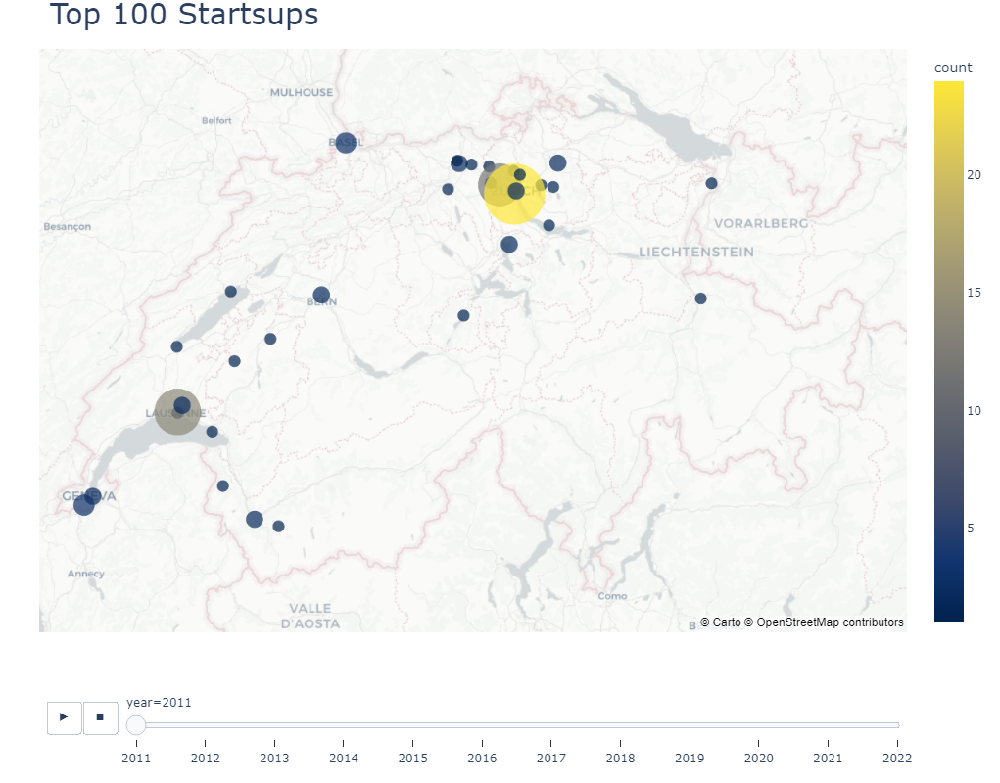

In [287]:

fig = px.scatter_mapbox(df_all_startups_canton_groupped_Year, lat="lon", lon="lan",
                        color="count", size="count",
                        mapbox_style = 'carto-positron',
                        color_continuous_scale='cividis', 
                        size_max=50, 
                        zoom=7, 
                        width = 1000,  
                        height=800,
                        center={"lat": 46.8, "lon": 8.3},
                        animation_frame="year",)


fig.update_layout(title_text="Top 100 Startsups",
                  margin=dict(l=40, r=30, t=50, b=20),
                
                  title_font_size=30)
fig.show()

In [282]:
df_all_startups_canton_groupped_Year = df_all_startups_canton.groupby(['headquarter', 'lan', 'lon', 'year', 'category']).size().reset_index(name="count")
df_all_startups_canton_groupped_Year = df_all_startups_canton_groupped_Year.sort_values('year', ascending = True)
df_all_startups_canton_groupped_Year

,headquarter,lan,lon,year,category,count
135,Fribourg,7.163626,46.806658,2011,Cleantech,1
523,Staufen,8.159970,47.378760,2011,Engineering,1
524,StÃ¤fa,8.725429,47.240885,2011,Fintech,1
538,Vevey,6.837315,46.449638,2011,ICT,1
539,Villaz-St-Pierre,6.962150,46.720916,2011,Medtech,1
...,...,...,...,...,...,...
505,Sion,7.354727,46.227254,2022,Cleantech,1
493,Schlieren,8.449002,47.395034,2022,Medtech,1
492,Schlieren,8.449002,47.395034,2022,Engineering,1
78,Collonges,7.055939,46.180352,2022,Cleantech,1
